# Processing of the "Construction of residentials" dataset

## Importing libraries and dataset

In [1]:
import pandas as pd
import re
from matplotlib import pyplot as plt 
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
# pip install "folium>=0.12" matplotlib mapclassify
# pip install xlrd

# pip install keplergl
# pip install h3


In [2]:
df = pd.read_csv("https://minio.lab.sspcloud.fr/mligeret1/constructions_resid_geocoded_cleaned.csv",sep=",",on_bad_lines="warn")


/tmp/ipykernel_505101/433425278.py:1: DtypeWarning: Columns (4,6,24,32,34,36,38,110,116,119) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("https://minio.lab.sspcloud.fr/mligeret1/constructions_resid_geocoded_cleaned.csv",sep=",",on_bad_lines="warn")


In [3]:
df.head()

,Unnamed: 0.1,Unnamed: 0,Code de la région du lieu des travaux - Code de la zone,Code de la région du lieu des travaux - Libellé de la zone,Code du département du lieu des travaux - Code de la zone,Code du département du lieu des travaux - Libellé de la zone,Code de la commune du lieu des travaux,"Type de DAU -- demande d’autorisation d’urbanisme (PC ou DP généralement, rarement PA)",Numéro d’enregistrement de la DAU,Etat d’avancement du projet,...,result_name,result_street,result_postcode,result_city,result_context,result_citycode,result_oldcitycode,result_oldcity,result_district,result_status
0,0,1,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0003,5,...,Rue de Munetville,Rue de Munetville,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
1,1,2,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0004,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
2,2,3,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0006,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
3,3,4,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0007,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
4,4,5,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0008,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok


In [4]:
df = df.iloc[1:] #we delete the first line that indicates the code for the variable 
df.head()

,Unnamed: 0.1,Unnamed: 0,Code de la région du lieu des travaux - Code de la zone,Code de la région du lieu des travaux - Libellé de la zone,Code du département du lieu des travaux - Code de la zone,Code du département du lieu des travaux - Libellé de la zone,Code de la commune du lieu des travaux,"Type de DAU -- demande d’autorisation d’urbanisme (PC ou DP généralement, rarement PA)",Numéro d’enregistrement de la DAU,Etat d’avancement du projet,...,result_name,result_street,result_postcode,result_city,result_context,result_citycode,result_oldcitycode,result_oldcity,result_district,result_status
1,1,2,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0004,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
2,2,3,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0006,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
3,3,4,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0007,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
4,4,5,82,Rhône-Alpes,1,Ain,1001,PC,00100113V0008,6,...,Lotissement le Panoramique,Lotissement le Panoramique,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok
5,5,6,82,Rhône-Alpes,1,Ain,1001,PC,00100114V0001,5,...,Chemin de l'Ordre,Chemin de l'Ordre,1400.0,L'Abergement-Clémenciat,"01, Ain, Auvergne-Rhône-Alpes",01001,NaN,NaN,NaN,ok


## Grouping columns together
To do so, we target columns with the same name

In [5]:
for c in df.columns:
    print(c)

Unnamed: 0.1
Unnamed: 0
Code de la région du lieu des travaux - Code de la zone
Code de la région du lieu des travaux - Libellé de la zone
Code du département du lieu des travaux - Code de la zone
Code du département du lieu des travaux - Libellé de la zone
Code de la commune du lieu des travaux
Type de DAU -- demande d’autorisation d’urbanisme (PC ou DP généralement, rarement PA)
Numéro d’enregistrement de la DAU
Etat d’avancement du projet
Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale
Date réelle d’ouverture de chantier
Date réelle d’achèvement des travaux
Année de dépôt de la DAU
Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation)
Date (mois) de prise en compte (DPC) de l’autorisation initiale
Date (mois) de prise en compte (DPC) de l’ouverture du chantier
Date (mois) (DPC) de dernière mise à jour des données
Catégorie du demandeur (maître d’ouvrage) selon Sitadel
Code d’activité principale de l’établ

In [6]:
col_metadata = [x for x in df.columns if "DAU" in x] + ["Unnamed: 0"]
col_meta_location = [x for x in df.columns if "lieu des travaux" in x]
col_dates_travaux = [x for x in df.columns if "Date" in x]
col_demandeurs = [x for x in df.columns if "demandeur" in x ]
col_precise_location = [x for x in df.columns if "du terrain" in x and ("Superficie du terrain" not in x)] 
col_cadastres = [x for x in df.columns if "cadastr" in x]
col_construction_details = [x for x in df.columns if "Présence" in x or "Indicateur" in x] #dans le projet 
col_number_created_housings_details = [x for x in df.columns if "logements" in x and "créés" in x and "Nombre total de logements créés" not in x]
col_details_transf = [x for x in df.columns if "Surface" in x]
col_from_geocodage = [i for i in df.columns if "result_" in i]

col_irrelevant = col_metadata + col_dates_travaux + col_precise_location + col_cadastres + col_construction_details + col_number_created_housings_details + col_details_transf + col_from_geocodage
col_relevant =  [c for c in df.columns if c not in col_irrelevant] 
for c in col_relevant:
    print(c)

Unnamed: 0.1
Code de la région du lieu des travaux - Code de la zone
Code de la région du lieu des travaux - Libellé de la zone
Code du département du lieu des travaux - Code de la zone
Code du département du lieu des travaux - Libellé de la zone
Code de la commune du lieu des travaux
Etat d’avancement du projet
Catégorie du demandeur (maître d’ouvrage) selon Sitadel
Code d’activité principale de l’établissement d’un demandeur avéré en tant que personne morale
Catégorie juridique d’un demandeur avéré en tant que personne morale
Dénomination d’un demandeur avéré en tant que personne morale
Numéro SIREN d’un demandeur avéré en tant que personne morale
Numéro SIRET d’un demandeur avéré en tant que personne morale
Code postal du demandeur
Localité du demandeur
Superficie du terrain
Code zone opératoire
Nature du projet déclarée par le demandeur
Nature de projet détaillée
Destination principale
Type principal de transformation
Type principal des locaux d’origine transformés
Nombre de niveau

In [7]:
df.loc[:,col_relevant].sample()



,Unnamed: 0.1,Code de la région du lieu des travaux - Code de la zone,Code de la région du lieu des travaux - Libellé de la zone,Code du département du lieu des travaux - Code de la zone,Code du département du lieu des travaux - Libellé de la zone,Code de la commune du lieu des travaux,Etat d’avancement du projet,Catégorie du demandeur (maître d’ouvrage) selon Sitadel,Code d’activité principale de l’établissement d’un demandeur avéré en tant que personne morale,Catégorie juridique d’un demandeur avéré en tant que personne morale,...,Type d’annexe,Type de résidence,Nombre total de logements créés,Nombre de logements démolis,Nb de logements locatifs sociaux,Nb de logements aidé (hors ptz),Nb de logements ptz,Adresse_complete,longitude,latitude
170642,170642,25,Basse-Normandie,14,Calvados,14241,2,10,NaN,NaN,...,7,9,1,0,0,0,0,LE BOURG EPINAY-SUR-ODON,-0.620836,49.0761


In [8]:
plt.figure(figsize=(20,10))

#sns.heatmap(df.isna(), cbar=False)


<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

In [9]:
df["Nombre total de logements créés"].sample()

351337    1
Name: Nombre total de logements créés, dtype: int64

#### **REACTIVER A LA FIN, DESACTIVER TEMPORAIREMENT**

def identification_usage(ligne):
    col_max = ligne.iloc[len(dates_lieux_travaux):].idxmax()
    pattern = r"Surface de plancher de la destination (.+?) (nouvelle construite|issue d'une transformation)$"

    match = re.search(pattern, col_max, re.IGNORECASE)
    print("Testing column:", repr(col_max))
    return match.group(1) if match else None

df_usage = df.loc[:,colonnes_pertinentes].sample(1000)
df_usage["Destination du lieu"]= df_usage.apply(identification_usage, axis = 1)



## Arranging columns types 


In [10]:
dico_variables = pd.read_excel("https://data.statistiques.developpement-durable.gouv.fr/dido/api/files/ab799b04-0b03-4f96-949c-eb23c478a8e8")

In [11]:
dico_variables.head()


,Nom de la variable,Description de la variable,Nouveau mai 2022?,Modalités,Format,Observations,Origine
0,REG,Code de la région du lieu des travaux,NaN,Nomenclature du Code Officiel Géographique (CO...,"Alphanumérique, 2 caractères",NaN,Numéro d'enregistrement de la DAU
1,DEP,Code du département du lieu des travaux,NaN,NaN,"Alphanumérique, 2 caractères",NaN,Numéro d'enregistrement de la DAU
2,COMM,Code de la commune du lieu des travaux,NaN,Nomenclature du Code Officiel Géographique (CO...,"Alphanumérique, 5 caractères",Le code vient directement du numéro d'enregist...,Numéro d'enregistrement de la DAU
3,Type_DAU,Type de DAU -- demande d'autorisation d'urbani...,NaN,PC (Permis de construire)\nDP (Déclaration Pré...,"Alphanumérique, 2 caractères",NaN,Numéro d'enregistrement de la DAU
4,Num_DAU,Numéro d'enregistrement de la DAU,NaN,NaN,"Alphanumérique, 13 caractères",Numéro sur 13 caractères : les 6 premiers cara...,Numéro d'enregistrement de la DAU


### Retrouver depuis le dictionnaire 

In [12]:
def variable_types(ligne):
    if ("Année" in ligne["Description de la variable"]):
        return None
    if "Alphanumérique" in ligne["Format"]:
        return "string"
    if "Numérique" in ligne["Format"]:
        return "float64"
        
dico_variables["Format_python"] = dico_variables.apply(variable_types, axis=1)


In [13]:
dtype_map = dict(zip(dico_variables["Description de la variable"], dico_variables["Format_python"]))
dtype_map = {col : python_type for col, python_type in dtype_map.items() if col in df.columns}
df = df.astype(dtype_map, errors="ignore")


In [14]:
df.dtypes.to_frame().style

,0
Unnamed: 0.1,int64
Unnamed: 0,int64
Code de la région du lieu des travaux - Code de la zone,int64
Code de la région du lieu des travaux - Libellé de la zone,object
Code du département du lieu des travaux - Code de la zone,object
Code du département du lieu des travaux - Libellé de la zone,object
Code de la commune du lieu des travaux,string
"Type de DAU -- demande d’autorisation d’urbanisme (PC ou DP généralement, rarement PA)",object
Numéro d’enregistrement de la DAU,object
Etat d’avancement du projet,int64


### Régler la question de la date 

In [15]:
df["Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation)"].value_counts().to_frame().style #to verify that dates are well specified under the format %Y%m, i.e. year with 4 digits followed by month
df["Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation)"] = pd.to_datetime(df["Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation)"], format="%Y-%m", errors="coerce")


We repeat the operation for the other columns that involve date/year dtypes


In [16]:
for col_date in col_dates_travaux:
    print(df[col_date].value_counts().to_frame()) #to verify the format of the date

                                                    count
Date réelle d’autorisation (PC) ou de non-oppos...       
2013-02-21                                           1603
2013-02-28                                           1340
2022-02-10                                           1260
2013-02-20                                           1215
2013-02-14                                           1208
...                                                   ...
2025-11-01                                              2
2020-05-01                                              2
2025-11-10                                              2
2025-09-14                                              2
2025-11-13                                              1

[4695 rows x 1 columns]
                                     count
Date réelle d’ouverture de chantier       
2014-09-01                            1447
2021-09-01                            1432
2021-03-01                            1349
2018-1

In [17]:
col_date_format_ymd = [col_dates_travaux[i] for i in [0,1,2,3]]
col_date_format_ym = [col_dates_travaux[i] for i in [4,5,6]]

In [18]:
for col in col_date_format_ymd:
    print(df[col])
    df[col] = pd.to_datetime(df[col], format="%Y-%m-%d")



1          2013-09-30
2          2013-09-20
3          2013-11-16
4          2013-12-06
5          2014-04-09
              ...    
1834049    2025-04-21
1834050    2013-08-15
1834051    2013-08-15
1834052    2016-11-09
1834053    2024-10-16
Name: Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale, Length: 1834053, dtype: object
1          2013-12-06
2          2013-11-26
3          2014-01-24
4          2014-03-12
5          2014-06-16
              ...    
1834049           NaN
1834050    2015-02-05
1834051    2015-02-05
1834052           NaN
1834053           NaN
Name: Date réelle d’ouverture de chantier, Length: 1834053, dtype: object
1          2014-08-08
2          2014-06-27
3          2014-04-09
4          2014-11-14
5                 NaN
              ...    
1834049           NaN
1834050           NaN
1834051           NaN
1834052           NaN
1834053           NaN
Name: Date réelle d’achèvement des travaux, Length: 1834053, dtype: object
1         2013-08-01

In [19]:
for col in col_date_format_ym:
    print(df[col])
    df[col] = pd.to_datetime(df[col], format="%Y-%m")


1          2013-10
2          2013-11
3          2013-11
4          2013-12
5          2014-04
            ...   
1834049    2025-04
1834050    2014-02
1834051    2014-02
1834052    2017-01
1834053    2024-10
Name: Date (mois) de prise en compte (DPC) de l’autorisation initiale, Length: 1834053, dtype: object
1          2014-01
2          2013-12
3          2014-02
4          2014-03
5          2014-07
            ...   
1834049        NaN
1834050    2015-02
1834051    2015-02
1834052        NaN
1834053        NaN
Name: Date (mois) de prise en compte (DPC) de l’ouverture du chantier, Length: 1834053, dtype: object
1          2014-08
2          2014-07
3          2014-04
4          2015-02
5          2014-07
            ...   
1834049    2025-04
1834050    2015-02
1834051    2015-02
1834052    2017-01
1834053    2024-10
Name: Date (mois) (DPC) de dernière mise à jour des données, Length: 1834053, dtype: object


In [20]:
col = "Année de dépôt de la DAU"
print(df[col])
df[col] = df[col].astype("int64")

1          2013
2          2013
3          2013
4          2013
5          2014
           ... 
1834049    2025
1834050    2013
1834051    2013
1834052    2016
1834053    2024
Name: Année de dépôt de la DAU, Length: 1834053, dtype: int64


### Compléter les dernières colonnes

In [21]:
df = df.astype({col : "float64" for col in col_details_transf + ["Superficie du terrain"]})

df = df.astype({col : "string" for col in col_meta_location + col_cadastres + ["Code zone opératoire"]})
df = df.astype({col : "string" for col in ["Adresse_complete"]})


In [22]:
df.dtypes.to_frame().style

,0
Unnamed: 0.1,int64
Unnamed: 0,int64
Code de la région du lieu des travaux - Code de la zone,string
Code de la région du lieu des travaux - Libellé de la zone,string
Code du département du lieu des travaux - Code de la zone,string
Code du département du lieu des travaux - Libellé de la zone,string
Code de la commune du lieu des travaux,string
"Type de DAU -- demande d’autorisation d’urbanisme (PC ou DP généralement, rarement PA)",object
Numéro d’enregistrement de la DAU,object
Etat d’avancement du projet,int64


## Cleaning per column



### Cleaning dates 

In [23]:
df.loc[:,col_dates_travaux].sample(5)


,Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale,Date réelle d’ouverture de chantier,Date réelle d’achèvement des travaux,Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation),Date (mois) de prise en compte (DPC) de l’autorisation initiale,Date (mois) de prise en compte (DPC) de l’ouverture du chantier,Date (mois) (DPC) de dernière mise à jour des données
560925,2017-04-18,2017-08-18,2018-04-01,2017-01-01,2017-04-01,2018-05-01,2018-05-01
961243,2021-10-21,2022-01-21,2022-08-23,2021-09-01,2021-10-01,2023-01-01,2023-01-01
1566916,2017-04-14,2017-05-15,NaT,2017-02-01,2017-05-01,2017-06-01,2017-06-01
658245,2022-09-08,NaT,NaT,2022-05-01,2023-08-01,NaT,2023-09-01
1749670,2018-04-03,2020-12-15,2022-11-21,2018-02-01,2018-04-01,2020-12-01,2022-11-01


On regarde si les dates mis à part la colonne des années sont cohérentes, ce qui semble être le cas 

In [24]:
df[df[col_dates_travaux].gt(pd.Timestamp.today()).any(axis=1)][col_dates_travaux+["Année de dépôt de la DAU"]].head(20)


,Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale,Date réelle d’ouverture de chantier,Date réelle d’achèvement des travaux,Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation),Date (mois) de prise en compte (DPC) de l’autorisation initiale,Date (mois) de prise en compte (DPC) de l’ouverture du chantier,Date (mois) (DPC) de dernière mise à jour des données,Année de dépôt de la DAU


In [25]:
df[df["Année de dépôt de la DAU"]>2025][col_dates_travaux+["Année de dépôt de la DAU"]].sample(5)


,Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale,Date réelle d’ouverture de chantier,Date réelle d’achèvement des travaux,Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation),Date (mois) de prise en compte (DPC) de l’autorisation initiale,Date (mois) de prise en compte (DPC) de l’ouverture du chantier,Date (mois) (DPC) de dernière mise à jour des données,Année de dépôt de la DAU
1753559,2014-02-27,NaT,NaT,2014-02-01,2014-03-01,NaT,2014-03-01,2098
3947,2013-04-03,NaT,NaT,2013-04-01,2013-04-01,NaT,2013-04-01,2098
1443919,2013-02-14,NaT,NaT,2012-10-01,2013-02-01,NaT,2013-02-01,2091
1535657,2014-02-13,2014-02-13,2014-03-18,2014-04-01,2014-04-01,2014-04-01,2014-04-01,2099
143298,2013-07-18,NaT,NaT,2013-07-01,2013-07-01,NaT,2013-07-01,2097


In [26]:
ligns_gt_today = df["Année de dépôt de la DAU"]>2025
df.loc[ligns_gt_today,"Année de dépôt de la DAU"] = df.loc[ligns_gt_today,"Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation)"].dt.year

In [27]:
df[df["Année de dépôt de la DAU"]>2025][col_dates_travaux+["Année de dépôt de la DAU"]].head(20)


,Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale,Date réelle d’ouverture de chantier,Date réelle d’achèvement des travaux,Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation),Date (mois) de prise en compte (DPC) de l’autorisation initiale,Date (mois) de prise en compte (DPC) de l’ouverture du chantier,Date (mois) (DPC) de dernière mise à jour des données,Année de dépôt de la DAU


On cherche à voir les années avant lesquelles il y a peu de données et qu'il vaut mieux supprimer pour l'analyse statistique 

<Axes: xlabel='Année de dépôt de la DAU'>

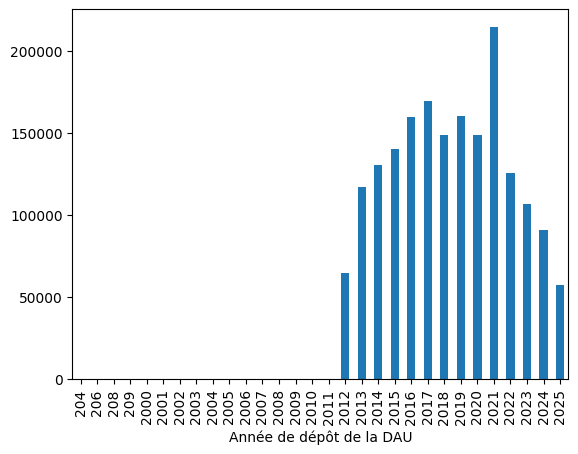

In [28]:
df["Année de dépôt de la DAU"].value_counts().sort_index().plot.bar()


On peut supprimer tout ce qui vient avant 2012, 2012 compris ainsi que l'année 2025 qui est en cours 

In [29]:
ligns_few_values = (df["Année de dépôt de la DAU"]<=2012) | (df["Année de dépôt de la DAU"] == 2025)
df = df.drop(df.index[ligns_few_values])

<Axes: xlabel='Année de dépôt de la DAU'>

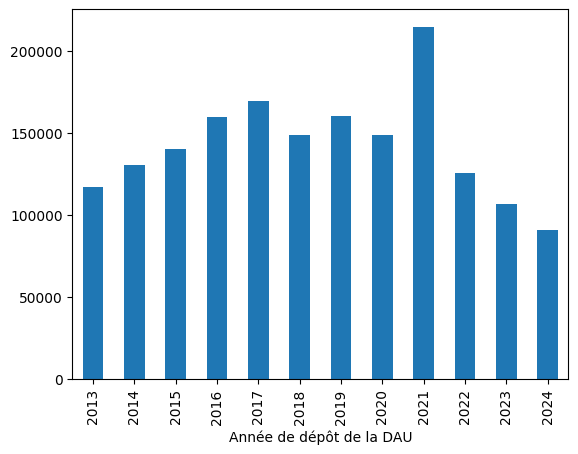

In [30]:
df["Année de dépôt de la DAU"].value_counts().sort_index().plot.bar()


### Cleaning Departments 

In [31]:
df["Code du département du lieu des travaux - Code de la zone"].nunique()

102

We see that there are 102 departments instead of 101, as for the previous notebook, we imagine that the problem is that one department is coded two times, one time with one digit (2, Aisne) and the other with two (02, Aisne). We harmonize the gap

In [32]:
df.loc[df["Code du département du lieu des travaux - Code de la zone"].str.len()==1,"Code du département du lieu des travaux - Code de la zone"] 

1          1
2          1
3          1
4          1
5          1
          ..
1808896    9
1808897    9
1808898    9
1808899    9
1808900    9
Name: Code du département du lieu des travaux - Code de la zone, Length: 92996, dtype: string

In [33]:
df["Code du département du lieu des travaux - Code de la zone"]=df["Code du département du lieu des travaux - Code de la zone"].str.zfill(2)

### Isolating overseas departments (DOM)

In [34]:
df_dom = df.loc[df["Code du département du lieu des travaux - Code de la zone"].str.startswith("97")] 
df = df.drop(df_dom.index)

<Axes: xlabel='Année de dépôt de la DAU'>

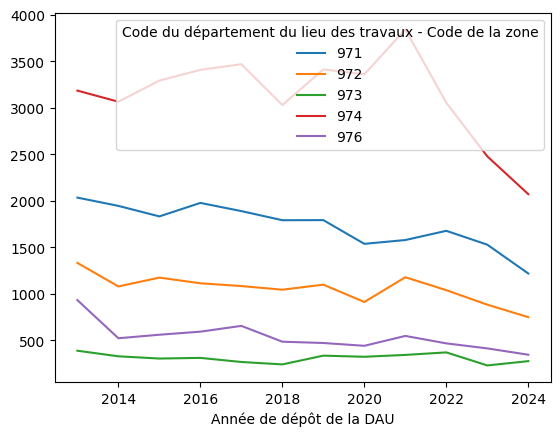

In [35]:
df_dom.groupby(["Code du département du lieu des travaux - Code de la zone", "Année de dépôt de la DAU"]).size().unstack(0).sort_index().plot()


###  TODO Replacing qualitative numeric value by its name 

In [36]:
destinations = [
    "habitation",
    "hébergement hôtelier",
    "bureaux",
    "commerce",
    "artisanat",
    "industrie",
    "agriculture",
    "entrepôt",
    "service public ou d'intérêt collectif"
]

dict_destination_principale = {key: value for key, value in zip(range(1, 10), destinations)}


In [37]:
df.loc[~df["Destination principale"].isin(range(1, 10)),"Destination principale"]

1          1
2          1
3          1
4          1
5          1
          ..
1833308    1
1833309    1
1833310    1
1833311    1
1833312    1
Name: Destination principale, Length: 1630058, dtype: string

In [38]:

df["Destination principale"] = pd.to_numeric(df["Destination principale"],errors="coerce")
df["Destination principale"] = df["Destination principale"].apply(lambda x : dict_destination_principale[x])


## First descriptive statistics 

### TODO : Main usage of the building before and after 

In [39]:
df["Destination principale"].value_counts()

Destination principale
habitation    1630058
Name: count, dtype: int64

### Construction Activity Time Series

<Axes: xlabel='Année de dépôt de la DAU'>

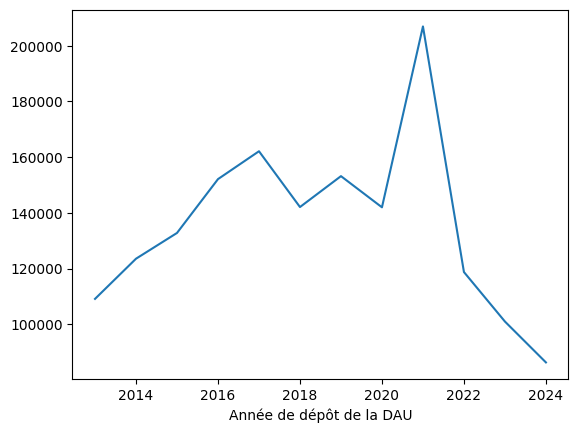

In [40]:
df["Année de dépôt de la DAU"].value_counts().sort_index().plot()


In [41]:
df["Date"] = df["Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation)"]


In [42]:
df[df["Date"].dt.year<=2012][col_dates_travaux+["Année de dépôt de la DAU"]]


,Date réelle d’autorisation (PC) ou de non-opposition (DP) initiale,Date réelle d’ouverture de chantier,Date réelle d’achèvement des travaux,Date (mois) de prise en compte (DPC) du premier évènement reçu dans Sitadel (dépôt de la demande ou autorisation),Date (mois) de prise en compte (DPC) de l’autorisation initiale,Date (mois) de prise en compte (DPC) de l’ouverture du chantier,Date (mois) (DPC) de dernière mise à jour des données,Année de dépôt de la DAU
33716,2013-02-15,NaT,NaT,2012-12-01,2013-02-01,NaT,2013-02-01,2013
69384,2013-02-27,NaT,NaT,2012-12-01,2013-02-01,NaT,2013-02-01,2013
129309,2013-06-24,2014-12-18,2016-08-31,2012-12-01,2013-06-01,2014-12-01,2016-09-01,2013
145209,2013-04-23,2013-05-01,2014-10-03,2012-12-01,2013-04-01,2013-12-01,2014-10-01,2013
316493,2013-01-22,NaT,NaT,2012-12-01,2013-01-01,NaT,2013-01-01,2013
454725,2013-06-19,2014-06-05,2016-04-08,2012-12-01,2013-06-01,2014-06-01,2016-08-01,2013
494688,2013-02-28,2013-03-07,2016-05-10,2012-12-01,2013-02-01,2013-03-01,2021-09-01,2013
676562,2020-07-29,2020-08-01,NaT,2010-03-01,2020-11-01,2021-02-01,2021-02-01,2020
687073,2020-03-06,2020-07-01,2021-01-01,2010-06-01,2020-03-01,2020-10-01,2021-06-01,2020
701265,2013-01-18,NaT,NaT,2012-12-01,2013-12-01,NaT,2013-12-01,2013


(array([2.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 1.9699e+04, 4.9304e+04, 4.3672e+04,
        5.1513e+04, 4.9225e+04, 4.2507e+04, 5.4800e+04, 5.5257e+04,
        4.8526e+04, 6.2422e+04, 7.0597e+04, 5.4236e+04, 6.8072e+04,
        5.6268e+04, 4.7725e+04, 6.2258e+04, 6.5801e+04, 5.1762e+04,
        5.2367e+04, 5.8601e+04, 5.6654e+04, 7.5062e+04, 7.5336e+04,
        6.6221e+04, 5.6605e+04, 5.1810e+04, 3.6432e+04, 4.1772e+04,
        3.7269e+04, 3.0415e+04, 3.5513e+04, 2.0090e+03, 3.4100e+02]),
 array([14669.   , 14811.325, 14953.65 , 15095.975, 15238.3  , 15380.625,
        15522.95 , 15665.275, 15807.6  , 15949.925, 16092.25 , 16234.575,
        16376.9  , 16519.225, 16661.55 , 16803.875, 16946.2  , 17088.525,
        17230.85 , 17373.175, 17515.5  , 17657.825, 17800.15 , 17942.475,
        18084.8  , 18227.125, 18369.45 , 18511.775, 18654.1  , 18796.425,
        18938.75 , 19081.075, 19223.4  , 19365.725, 19508.05 , 19650.375,
        19

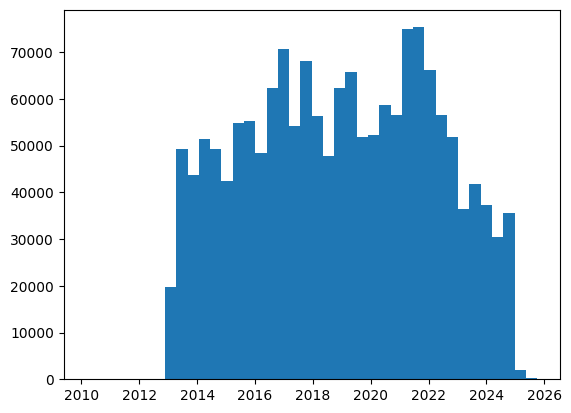

In [43]:
plt.hist(df["Date"], bins=40)    


### In which departments did we build the most ? 

#### ... some preliminary visualization

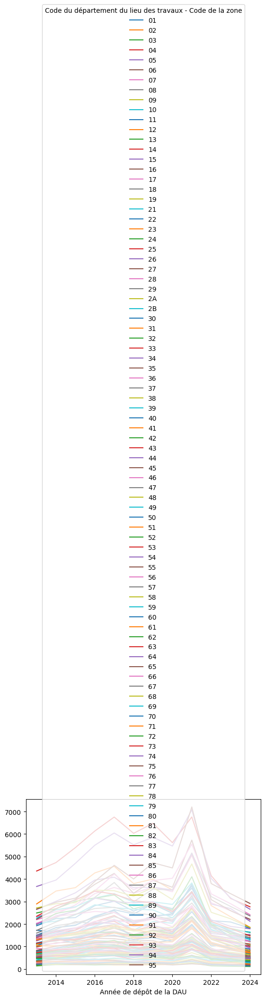

In [44]:
activity_per_department = df.groupby(["Code du département du lieu des travaux - Code de la zone", "Année de dépôt de la DAU"]).size().unstack(0).sort_index().plot()


array([[<Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>],
       [<Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année de dépôt de la DAU'>,
        <Axes: xlabel='Année d

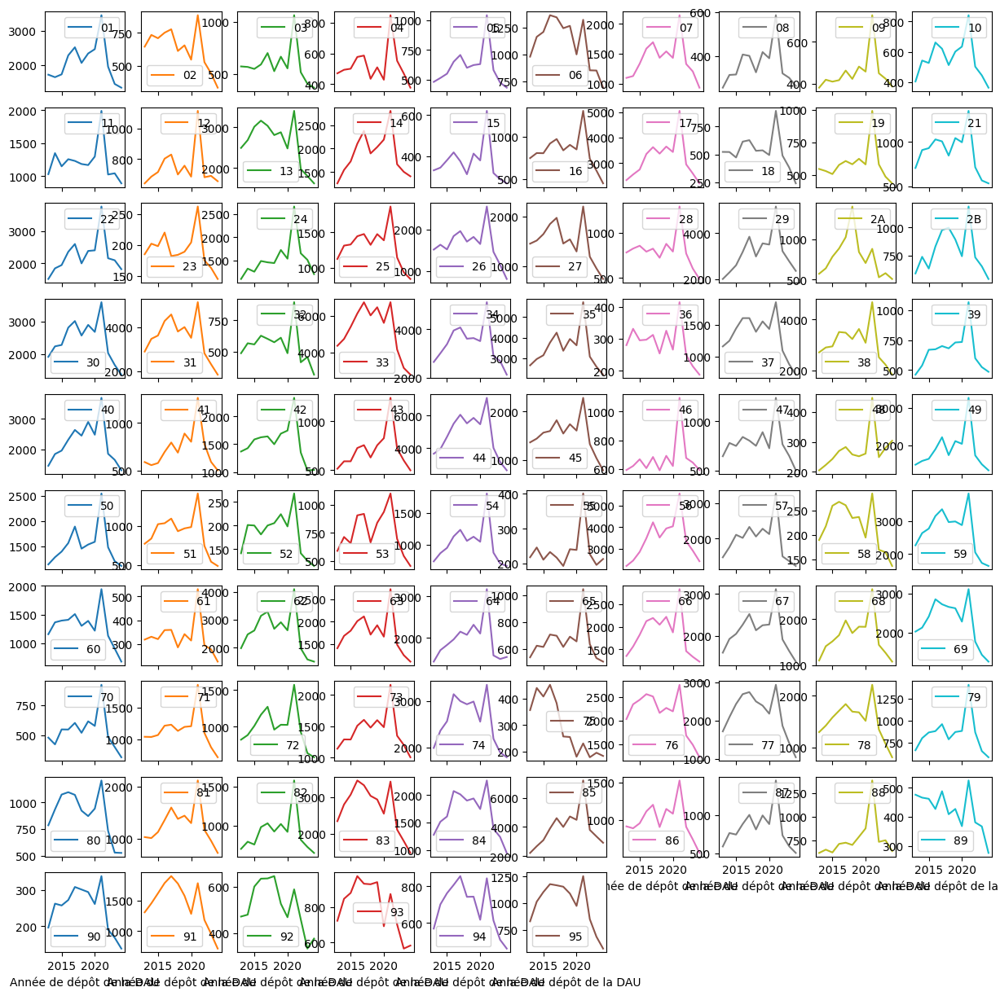

In [45]:
df.groupby(["Code du département du lieu des travaux - Code de la zone", "Année de dépôt de la DAU"]).size().unstack(0).sort_index().plot(
    subplots=True,
    layout=(10,10),
    figsize=(15,15),
    legend=True 
)


In [46]:
activity_per_department = df.groupby(["Code du département du lieu des travaux - Code de la zone", "Année de dépôt de la DAU"]).size().unstack(1)
activity_per_department.sample(4)

Année de dépôt de la DAU,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
Code du département du lieu des travaux - Code de la zone,,,,,,,,,,,,
10,405,543,527,662,621,513,602,635,842,503,445,364
76,2033,2345,2440,2559,2510,2163,2268,2196,2756,1686,1491,1228
39,462,539,670,674,701,682,731,735,1068,599,525,486
12,640,684,714,802,829,698,756,684,1116,680,689,654


It's not very convenient to read and analyze, let's try making it clearer, however we will this time try to answer it in a more direct fashion i.e. clustering groups of datas

#### Clustering groups of departments

In [47]:
X = activity_per_department.fillna(0)
X = (X - X.mean(axis=1).values[:, None]) / X.std(axis=1).values[:, None]


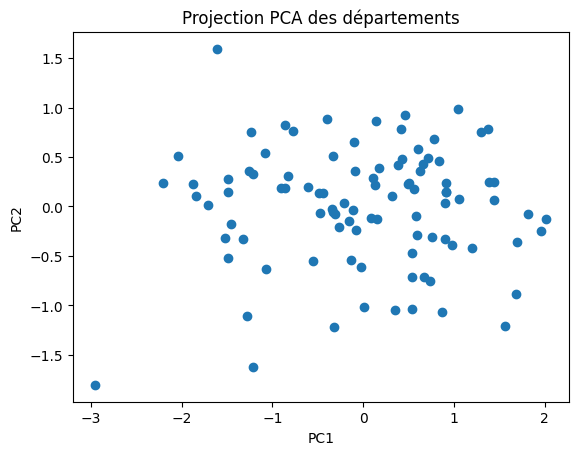

In [48]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X.values)

plt.scatter(X_pca[:,0], X_pca[:,1])
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Projection PCA des départements")
plt.show()


In [49]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=2, random_state=0)
labels = kmeans.fit_predict(X.values)

activity_per_department["cluster"] = labels


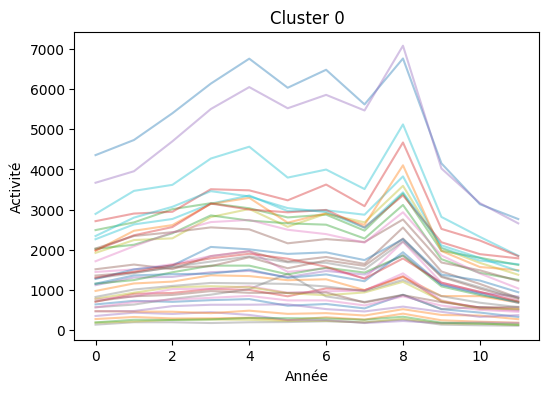

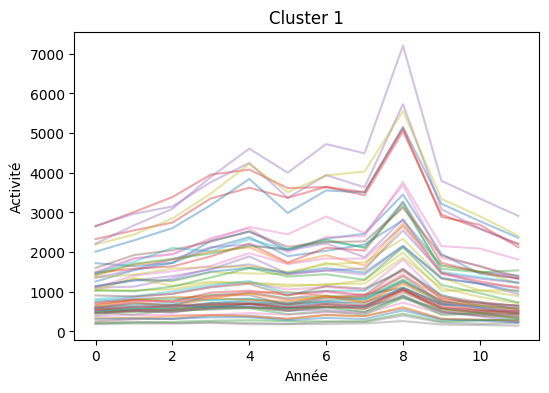

In [50]:
import matplotlib.pyplot as plt

for k in sorted(activity_per_department["cluster"].unique()):
    plt.figure(figsize=(6,4))
    for _, row in activity_per_department[
        activity_per_department["cluster"] == k
    ].drop(columns="cluster").iterrows():
        plt.plot(row.values, alpha=0.4)
    plt.title(f"Cluster {k}")
    plt.xlabel("Année")
    plt.ylabel("Activité")
    plt.show()


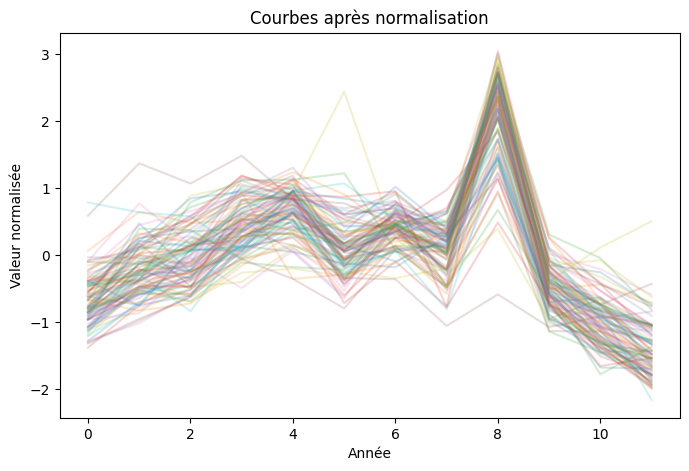

In [51]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
for _, row in X.iterrows():
    plt.plot(row.values, alpha=0.2)
plt.title("Courbes après normalisation")
plt.xlabel("Année")
plt.ylabel("Valeur normalisée")
plt.show()


Let's first determine for a given year, in which departments did we build the most 
#### Q1 : For the year 2024, in which department did we build the most ? 

In [52]:
construction_activity2024 = activity_per_department[2024].sort_values().reset_index()

In [53]:
construction_activity2024.nunique()

Code du département du lieu des travaux - Code de la zone    96
2024                                                         93
dtype: int64

#### -> Q1 : Let's represent departments on a map 

In [54]:
deps = gpd.read_file("https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements.geojson")

In [55]:
deps.index = deps.index.astype(str).str.zfill(2)
deps.head(50)


,code,nom,geometry
00,01,Ain,"POLYGON ((4.78021 46.17668, 4.78024 46.18905, ..."
01,02,Aisne,"POLYGON ((3.17296 50.01131, 3.17382 50.01186, ..."
02,03,Allier,"POLYGON ((3.03207 46.79491, 3.03424 46.7908, 3..."
03,04,Alpes-de-Haute-Provence,"POLYGON ((5.67604 44.19143, 5.67817 44.19051, ..."
04,05,Hautes-Alpes,"POLYGON ((6.26057 45.12685, 6.26417 45.12641, ..."
05,06,Alpes-Maritimes,"MULTIPOLYGON (((7.06711 43.51365, 7.06665 43.5..."
06,2A,Corse-du-Sud,"MULTIPOLYGON (((8.5864 41.87389, 8.58667 41.87..."
07,2B,Haute-Corse,"MULTIPOLYGON (((9.40875 43.02232, 9.40662 43.0..."
08,07,Ardèche,"POLYGON ((4.48313 45.23645, 4.4879 45.23218, 4..."
09,08,Ardennes,"POLYGON ((4.23316 49.95775, 4.2369 49.95858, 4..."


In [56]:
construction_activity2024 = construction_activity2024.merge(
    deps,
    left_on="Code du département du lieu des travaux - Code de la zone",
    right_on="code",
    how="left"
)

construction_activity2024.head(50)


,Code du département du lieu des travaux - Code de la zone,2024,code,nom,geometry
0,52,114,52,Haute-Marne,"POLYGON ((4.67018 48.53189, 4.67374 48.53396, ..."
1,58,137,58,Nièvre,"POLYGON ((2.87463 47.52042, 2.87074 47.52314, ..."
2,90,138,90,Territoire de Belfort,"POLYGON ((6.82354 47.81305, 6.82384 47.81426, ..."
3,23,145,23,Creuse,"POLYGON ((2.16779 46.42407, 2.17254 46.42228, ..."
4,75,184,75,Paris,"POLYGON ((2.3319 48.81701, 2.33247 48.81825, 2..."
5,36,188,36,Indre,"POLYGON ((1.32667 47.18623, 1.33849 47.19554, ..."
6,55,213,55,Meuse,"POLYGON ((4.95099 49.23687, 4.95795 49.23838, ..."
7,61,225,61,Orne,"POLYGON ((-0.84094 48.75222, -0.83818 48.75162..."
8,18,242,18,Cher,"POLYGON ((2.23921 47.62098, 2.24348 47.62084, ..."
9,08,263,08,Ardennes,"POLYGON ((4.23316 49.95775, 4.2369 49.95858, 4..."


In [57]:
construction_activity2024 = gpd.GeoDataFrame(
    construction_activity2024,
    geometry="geometry",
    crs=deps.crs
)

<Axes: >

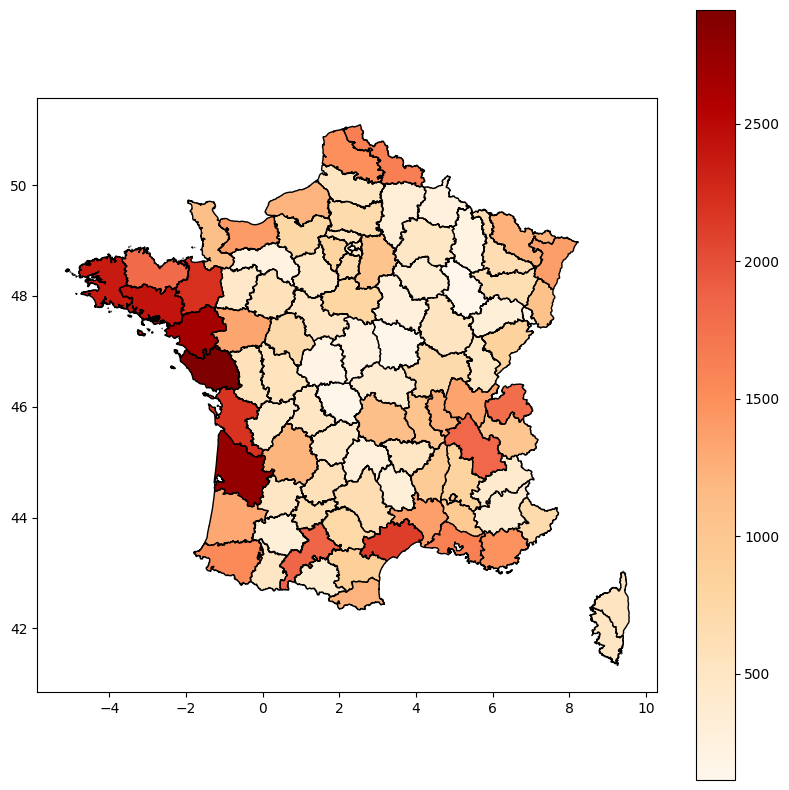

In [58]:
construction_activity2024.plot(
    column=2024,
    cmap="OrRd",
    legend=True,
    figsize=(10, 10),
    edgecolor="black"
) 

#### TODO -> Q1 What's happening in Bordeaux ? 

In [59]:
df.loc[
    df["Code du département du lieu des travaux - Code de la zone"] == "33",
    "Destination principale"
].value_counts()


Destination principale
habitation    62311
Name: count, dtype: int64

#### Q2 : In which department was growth the strongest ? 

In [60]:
growth_per_department = activity_per_department.pct_change(axis=1)



In [61]:
growth_per_department = growth_per_department.mean(axis=1).reset_index()


In [62]:
growth_per_department = growth_per_department.merge(
    deps,
    left_on="Code du département du lieu des travaux - Code de la zone",
    right_on="code",
    how="left"
)

In [63]:
growth_per_department = growth_per_department.rename(columns={0:"Avg_growth_rate"})

In [64]:
growth_per_department = gpd.GeoDataFrame(
    growth_per_department,
    geometry="geometry",
    crs=deps.crs
)

In [65]:
growth_per_department.columns

Index(['Code du département du lieu des travaux - Code de la zone',
       'Avg_growth_rate', 'code', 'nom', 'geometry'],
      dtype='object')

<Axes: >

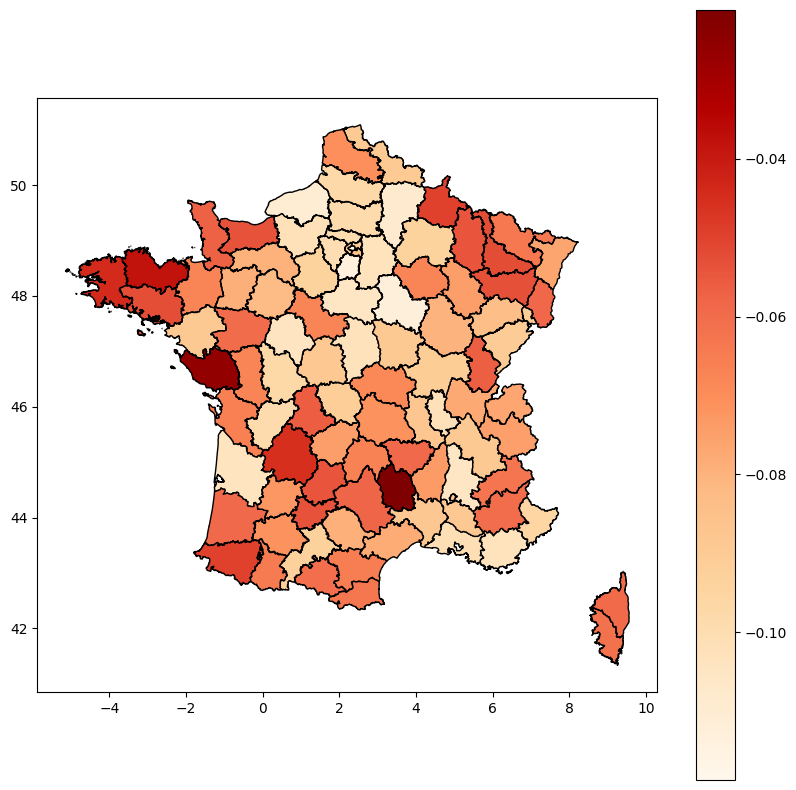

In [66]:
growth_per_department.plot(
    column="Avg_growth_rate",
    cmap="OrRd",
    legend=True,
    figsize=(10, 10),
    edgecolor="black"
) 

In [67]:
growth_per_department.sort_values(by="Avg_growth_rate", ascending=False).head(10)

,Code du département du lieu des travaux - Code de la zone,Avg_growth_rate,code,nom,geometry
48,48,-0.021113,48,Lozère,"POLYGON ((3.36134 44.97141, 3.36229 44.97131, ..."
85,85,-0.025868,85,Vendée,"MULTIPOLYGON (((-2.30479 46.70942, -2.30209 46..."
20,22,-0.038161,22,Côtes-d'Armor,"MULTIPOLYGON (((-3.47716 48.88127, -3.47863 48..."
27,29,-0.044336,29,Finistère,"MULTIPOLYGON (((-4.0004 47.72283, -4.00391 47...."
22,24,-0.045371,24,Dordogne,"POLYGON ((0.62974 45.71457, 0.63094 45.71328, ..."
64,64,-0.049427,64,Pyrénées-Atlantiques,"POLYGON ((-0.24284 43.58498, -0.24233 43.58342..."
7,08,-0.049565,08,Ardennes,"POLYGON ((4.23316 49.95775, 4.2369 49.95858, 4..."
54,54,-0.052042,54,Meurthe-et-Moselle,"MULTIPOLYGON (((5.45245 49.41235, 5.46144 49.4..."
56,56,-0.052444,56,Morbihan,"MULTIPOLYGON (((-3.01322 47.41074, -3.01772 47..."
88,88,-0.053060,88,Vosges,"POLYGON ((5.47006 48.42093, 5.48238 48.41582, ..."


In [68]:
activity_per_department.iloc[80:88]


Année de dépôt de la DAU,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,cluster
Code du département du lieu des travaux - Code de la zone,,,,,,,,,,,,,
80,786,935,1074,1096,1071,923,872,942,1206,734,530,527,0
81,1035,1016,1131,1360,1600,1383,1444,1302,2118,1173,965,732,1
82,699,791,755,979,1028,922,1019,918,1579,816,724,647,1
83,2344,2802,3071,3460,3329,3038,2939,2550,3430,2112,1800,1474,0
84,1277,1515,1610,2073,2013,1900,1938,1746,2266,1387,1238,947,0
85,2214,2675,3092,3896,4608,4003,4723,4492,7203,3798,3350,2914,1
86,910,884,952,1112,1201,901,1145,1081,1529,904,734,552,1
87,587,763,743,881,1000,810,993,880,1450,732,590,503,1


### In which places did we build the most ? (more granular analysis)

#### A visual answer

In [69]:
df.loc[:,col_relevant].head()

,Unnamed: 0.1,Code de la région du lieu des travaux - Code de la zone,Code de la région du lieu des travaux - Libellé de la zone,Code du département du lieu des travaux - Code de la zone,Code du département du lieu des travaux - Libellé de la zone,Code de la commune du lieu des travaux,Etat d’avancement du projet,Catégorie du demandeur (maître d’ouvrage) selon Sitadel,Code d’activité principale de l’établissement d’un demandeur avéré en tant que personne morale,Catégorie juridique d’un demandeur avéré en tant que personne morale,...,Type d’annexe,Type de résidence,Nombre total de logements créés,Nombre de logements démolis,Nb de logements locatifs sociaux,Nb de logements aidé (hors ptz),Nb de logements ptz,Adresse_complete,longitude,latitude
1,1,82,Rhône-Alpes,01,Ain,1001,6,10,NaN,NaN,...,2,9,1.0,0.0,0.0,0.0,0.0,LOT LE PANORAMIQUE LOT 7 L ABERGEMENT-CLEMENCIAT,4.921447,46.148537
2,2,82,Rhône-Alpes,01,Ain,1001,6,10,NaN,NaN,...,2,9,1.0,0.0,0.0,0.0,0.0,LOT LE PANORAMIQUE MUNETVILLE L ABERGEMENT-CLE...,4.921447,46.148537
3,3,82,Rhône-Alpes,01,Ain,1001,6,10,NaN,NaN,...,2,9,1.0,0.0,0.0,0.0,0.0,LOT LE PANORAMIQUE MUNETVILLE L ABERGEMENT-CLE...,4.921447,46.148537
4,4,82,Rhône-Alpes,01,Ain,1001,6,10,NaN,NaN,...,2,9,1.0,0.0,0.0,0.0,0.0,LOT LE PANORAMIQUE MUNETVILLE L ABERGEMENT-CLE...,4.921447,46.148537
5,5,82,Rhône-Alpes,01,Ain,1001,5,10,NaN,NaN,...,7,9,1.0,0.0,0.0,0.0,0.0,L ORDRE L ABERGEMENT-CLEMENCIAT,4.927974,46.142069


In [70]:
df['Geometry'] = df.apply(
    lambda x: Point(x["longitude"], x["latitude"]) 
    if x["longitude"] and x["latitude"] 
    else None,
    axis = 1
)

gdf = gpd.GeoDataFrame(
    df,              # les données
    geometry="Geometry",     # La colonne de géométrie
    crs='EPSG:4326'       # Système de coordonnées 
)

In [71]:
gdf = gdf.to_crs(epsg=2154)  # transformation du système de coordonnée pour plot hexbin


In [72]:
gdf_clean = gdf[
    (gdf.geometry.x.between(200_000, 1_200_000)) &
    (gdf.geometry.y.between(6_000_000, 7_200_000))
]


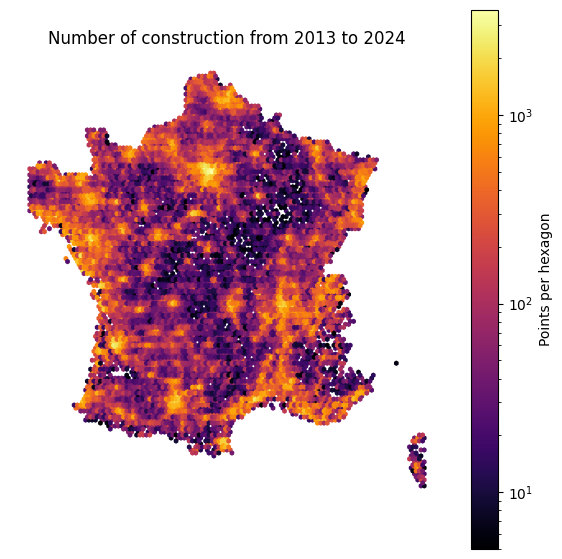

In [73]:
fig, ax = plt.subplots(figsize=(7, 7))

graph_heatmap_resid = ax.hexbin(
    gdf_clean.geometry.x,
    gdf_clean.geometry.y,
    gridsize=120,
    cmap="inferno",
    mincnt=5,
    bins="log" 
)

ax.set_aspect("equal")
ax.set_axis_off()

plt.colorbar(graph_heatmap_resid, label="Points per hexagon")
plt.title("Number of construction from 2013 to 2024")
plt.show()


We note that the previous chart uses a logarithmic scale, which means that a change from dark purple to pink represents 100 times more points, and from purple to yellow represents 1,000 times more points.

#### A zoom on the Paris region

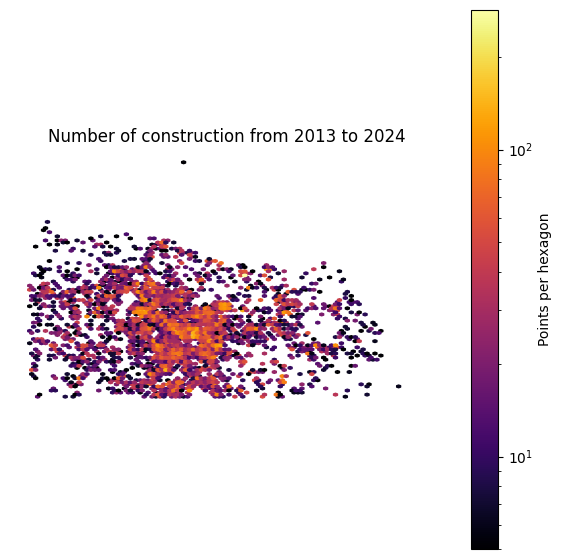

In [74]:
gdf_idf = gdf[gdf["Code de la région du lieu des travaux - Code de la zone"] == "11"]
gdf_idf = gdf_idf[
    gdf_idf.geometry.x.between(600_000, 750_000) &
    gdf_idf.geometry.y.between(6_840_000, 6_930_000)
]

fig, ax = plt.subplots(figsize=(7, 7))
graph_heatmap_resid_idf = ax.hexbin(
    gdf_idf.geometry.x,
    gdf_idf.geometry.y,
    gridsize=100,
    cmap="inferno",
    mincnt=5,
    bins="log" 
)

ax.set_aspect("equal")
ax.set_axis_off()


plt.colorbar(graph_heatmap_resid_idf, label="Points per hexagon")
plt.title("Number of construction from 2013 to 2024")
plt.show()

To better analyze this map, we can use Folium in order to have an interactive map

In [75]:
gdf_idf = gdf.loc[gdf["Code de la région du lieu des travaux - Code de la zone"] == "11"]


In [76]:
import folium
from folium.plugins import HeatMap

# passer en WGS84 (obligatoire pour folium)
gdf_wgs = gdf_idf.to_crs(epsg=4326)
gdf_wgs = gdf_wgs[
    gdf_wgs.geometry.notna() &
    ~gdf_wgs.geometry.is_empty &
    gdf_wgs.geometry.x.notna() &
    gdf_wgs.geometry.y.notna()
]

# centrer sur l'IDF
center = [
    gdf_wgs.geometry.y.mean(),
    gdf_wgs.geometry.x.mean()
]

m = folium.Map(
    location=center,
    zoom_start=9,
    tiles="CartoDB positron"
)

HeatMap(
    data=list(zip(
        gdf_wgs.geometry.y,
        gdf_wgs.geometry.x
    )),
    radius=10,
    blur=15
).add_to(m)

m


#### An analytical answer 

In [77]:
col_relevant =  [c for c in df.columns if c not in col_irrelevant] #on actualise pour ajouter la colonne géométrie nouvellement créée 
df.loc[:,col_relevant].sample()

,Unnamed: 0.1,Code de la région du lieu des travaux - Code de la zone,Code de la région du lieu des travaux - Libellé de la zone,Code du département du lieu des travaux - Code de la zone,Code du département du lieu des travaux - Libellé de la zone,Code de la commune du lieu des travaux,Etat d’avancement du projet,Catégorie du demandeur (maître d’ouvrage) selon Sitadel,Code d’activité principale de l’établissement d’un demandeur avéré en tant que personne morale,Catégorie juridique d’un demandeur avéré en tant que personne morale,...,Nombre total de logements créés,Nombre de logements démolis,Nb de logements locatifs sociaux,Nb de logements aidé (hors ptz),Nb de logements ptz,Adresse_complete,longitude,latitude,Date,Geometry
1019508,1019508,53,Bretagne,56,Morbihan,56214,6,10,NaN,NaN,...,1.0,0.0,0.0,0.0,0.0,12 IMPASSE DU GREHEU SAINT-GILDAS-DE-RHUYS,-2.833698,47.497947,2021-01-01,POINT (-2.833698 47.497947)


We then select a resolution for the hexagon, resolution 7 seem to be the optimal one as each hexagon will cover a surface of approximately 15m². Knowing there are approximately 1 million points in the database, each hexagon will have 

In [78]:
import h3


In [79]:
gdf = gpd.GeoDataFrame(
    df,              # les données
    geometry="Geometry",     # La colonne de géométrie
    crs='EPSG:4326'       # Système de coordonnées 
)

In [80]:
gdf["hexagon"] = gdf.geometry.apply(lambda coord : h3.latlng_to_cell(coord.x,coord.y,6))

In [81]:
construction_per_hexagon_total = (gdf.groupby("hexagon").size().reset_index(name="Number_construction_2013-2024"))


In [82]:
construction_per_hexagon_total.sample(5)

,hexagon,Number_construction_2013-2024
21372,867b1b907ffffff,7
6572,867a1a96fffffff,5
12420,867a8591fffffff,10
11380,867a81a97ffffff,27
14294,867aa1a0fffffff,35


In [83]:
import h3
import geopandas as gpd
from shapely.geometry import Polygon

def h3_get_polygon(hexagon):
    return Polygon(h3.cell_to_boundary(hexagon))

construction_per_hexagon_total["geometry"] = construction_per_hexagon_total["hexagon"].apply(h3_get_polygon)
construction_per_hexagon_total = gpd.GeoDataFrame(construction_per_hexagon_total, geometry="geometry", crs="EPSG:4326")




In [84]:
construction_per_hexagon_total.explore(
    column="Number_construction_2013-2024", 
    cmap="viridis",     
    location=[46.6, 2.5],  # France
    zoom_start=6,)

In [85]:
construction_per_hexagon = gdf.groupby(["hexagon", "Année de dépôt de la DAU"]).size().unstack(1).sort_index()

In [86]:
construction_per_hexagon = construction_per_hexagon.fillna(0)

In [87]:
construction_per_hexagon

Année de dépôt de la DAU,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
hexagon,,,,,,,,,,,,
8618c1927ffffff,7.0,2.0,3.0,4.0,8.0,7.0,7.0,5.0,8.0,4.0,4.0,0.0
8618c5297ffffff,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8618c529fffffff,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
8618c5647ffffff,0.0,0.0,4.0,1.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
8618c564fffffff,0.0,0.0,0.0,0.0,4.0,2.0,0.0,1.0,2.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
86e6e676fffffff,4.0,3.0,3.0,11.0,18.0,8.0,10.0,1.0,2.0,2.0,0.0,1.0
86e6e6d07ffffff,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
86e6e6d0fffffff,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [88]:
import numpy as np

log_growth_per_hexagon = np.log1p(construction_per_hexagon).diff(axis=1)



In [89]:
log_growth_per_hexagon  = log_growth_per_hexagon.mean(axis=1).sort_values(ascending=False).to_frame().reset_index()

In [90]:
log_growth_per_hexagon = log_growth_per_hexagon.rename(columns={0:"Avg_growth_rate"})

In [91]:
log_growth_per_hexagon

,hexagon,Avg_growth_rate
0,867a315a7ffffff,0.296191
1,867a35cd7ffffff,0.267676
2,867a2a8afffffff,0.252054
3,867b8daa7ffffff,0.252054
4,867a35737ffffff,0.239914
...,...,...
23031,867af42b7ffffff,-0.285045
23032,867af1697ffffff,-0.285045
23033,867a30927ffffff,-0.291895
23034,867aa5c0fffffff,-0.302928


In [92]:

log_growth_per_hexagon["geometry"] = log_growth_per_hexagon["hexagon"].apply(h3_get_polygon)
log_growth_per_hexagon = gpd.GeoDataFrame(log_growth_per_hexagon, geometry="geometry", crs="EPSG:4326")


In [93]:
log_growth_per_hexagon

,hexagon,Avg_growth_rate,geometry
0,867a315a7ffffff,0.296191,"POLYGON ((-0.86755 47.44251, -0.83659 47.4524,..."
1,867a35cd7ffffff,0.267676,"POLYGON ((-1.9844 47.87357, -1.95318 47.88339,..."
2,867a2a8afffffff,0.252054,"POLYGON ((-1.21549 43.9059, -1.18387 43.91665,..."
3,867b8daa7ffffff,0.252054,"POLYGON ((-0.4371 49.33974, -0.40663 49.34912,..."
4,867a35737ffffff,0.239914,"POLYGON ((-1.76324 47.58098, -1.73204 47.59087..."
...,...,...,...
23031,867af42b7ffffff,-0.285045,"POLYGON ((4.79627 44.54889, 4.82572 44.55922, ..."
23032,867af1697ffffff,-0.285045,"POLYGON ((6.08562 43.25043, 6.11476 43.26099, ..."
23033,867a30927ffffff,-0.291895,"POLYGON ((-1.69544 48.20496, -1.66437 48.21469..."
23034,867aa5c0fffffff,-0.302928,"POLYGON ((2.33755 49.26195, 2.36708 49.27125, ..."


In [94]:
log_growth_per_hexagon.explore(
    column="Avg_growth_rate",
    cmap="RdBu_r",
    vmin=-0.05,
    vmax=0.05,
    tiles="CartoDB positron",
    legend=True,
    legend_kwds={"caption": "Log-variation (échelle resserrée)"},
    location=[46.6, 2.5],  # France
    zoom_start=6,
)


### Are where real estate prices high where people create the most housings, an analysis on a more granular level 
Accordingly, the only reason why prices are different from one place to another is the difference in demand. 
We hereby take prices as an indicator of positive aggregate demand

# TODO : Discrétiser la variable POPULATION en utilisant 4 classes par le biais d’une discrétisation par quantile. Refaire la carte.